In [1182]:
!pip install geopy
!pip install plotly-express
!pip install -U folium

import pandas as pd
import numpy as np
import pytz
import plotly 
import geopy
import plotly.express as px
import folium
import matplotlib.pyplot as plt
import datetime
import warnings
import math

from geopy.geocoders import Nominatim
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap

In [1183]:
warnings.filterwarnings("ignore")

In [899]:
orders_raw= pd.read_csv('ISyE 6202 2022 Caseworks 3.1 and 3.2 Orders.csv')
meta = pd.read_excel('ISyE 6202 2022 Caseworks 3.1 and 3.2 MetaData.xlsx')
D_FC = pd.read_csv('ISyE 6202 2022 Caseworks 3.1 and 3.2 Distribution and Fulfillment Centers.csv')

xls = pd.ExcelFile('ISyE 6202 2022 Caseworks 3.1 and 3.2 MetaData.xlsx')
category = pd.read_excel(xls, 'Product Categorization')
dim = pd.read_excel(xls, 'Modular Package Dimensions')
sp_lead_times = pd.read_excel(xls, 'Supply Lead Times')
dilv_tim_com = pd.read_excel(xls, 'Delivery Time Commitment')

zips = pd.read_csv('ISyE 6202 2022 Caseworks 3.1 and 3.2 ZIP3 US.csv')

In [455]:
# specify dtype of each column
names = list(orders_raw.columns)
dtypes = ["datetime64[ns]",int,str,str,int,str,int]
orders_raw = orders_raw.astype(dict(zip(names,dtypes)))
orders_raw

,Order_Date,Product,product category,sub-category,ZIP_3d,Country,Quantity
0,2019-01-01,1,A,f,70,US,61
1,2019-01-01,1,A,f,70,US,84
2,2019-01-01,1,A,f,115,US,56
3,2019-01-01,1,A,f,191,US,65
4,2019-01-01,1,A,f,272,US,84
...,...,...,...,...,...,...,...
713568,2019-12-31,771,Y,s,322,US,70
713569,2019-12-31,771,Y,s,841,US,63
713570,2019-12-31,771,Y,s,852,US,59
713571,2019-12-31,777,Y,s,490,US,58


In [4]:
us_state_to_abbrev = {
    "Alabama": "AL",
    "Alaska": "AK",
    "Arizona": "AZ",
    "Arkansas": "AR",
    "California": "CA",
    "Colorado": "CO",
    "Connecticut": "CT",
    "Delaware": "DE",
    "Florida": "FL",
    "Georgia": "GA",
    "Hawaii": "HI",
    "Idaho": "ID",
    "Illinois": "IL",
    "Indiana": "IN",
    "Iowa": "IA",
    "Kansas": "KS",
    "Kentucky": "KY",
    "Louisiana": "LA",
    "Maine": "ME",
    "Maryland": "MD",
    "Massachusetts": "MA",
    "Michigan": "MI",
    "Minnesota": "MN",
    "Mississippi": "MS",
    "Missouri": "MO",
    "Montana": "MT",
    "Nebraska": "NE",
    "Nevada": "NV",
    "New Hampshire": "NH",
    "New Jersey": "NJ",
    "New Mexico": "NM",
    "New York": "NY",
    "North Carolina": "NC",
    "North Dakota": "ND",
    "Ohio": "OH",
    "Oklahoma": "OK",
    "Oregon": "OR",
    "Pennsylvania": "PA",
    "Rhode Island": "RI",
    "South Carolina": "SC",
    "South Dakota": "SD",
    "Tennessee": "TN",
    "Texas": "TX",
    "Utah": "UT",
    "Vermont": "VT",
    "Virginia": "VA",
    "Washington": "WA",
    "West Virginia": "WV",
    "Wisconsin": "WI",
    "Wyoming": "WY",
    "District of Columbia": "DC",
    "American Samoa": "AS",
    "Guam": "GU",
    "Northern Mariana Islands": "MP",
    "Puerto Rico": "PR",
    "United States Minor Outlying Islands": "UM",
    "U.S. Virgin Islands": "VI",
}

# 1. 2019 Demand Analysis

## a. Characterize and analyze the demand share of each state, and three-digit zip code, globally and by product category. Depict the relative demand shares using heatmaps.

In [5]:
orders=orders_raw.copy()
orders['ZIP_str'] = [str(x).zfill(3) + '00' for x in orders['ZIP_3d']]
zips['ZIP_3d'] = zips['ZIP3']
zips.drop(axis = 1, columns = ['ZIP3'])
orders = pd.merge(orders, zips, on='ZIP_3d')
orders.columns

Index(['Order_Date', 'Product', 'product category', 'sub-category', 'ZIP_3d',
       'Country', 'Quantity', 'ZIP_str', 'ZIP3', 'Lat', 'Lon'],
      dtype='object')

In [6]:
# coordinates globally
glob = orders.groupby(['Lat', 'Lon'])['Quantity'].sum()
glob = pd.DataFrame(data = glob).reset_index()

In [905]:
# coordinates by product categroy
product_cate = orders.groupby(['Lat', 'Lon','product category'])['Quantity'].sum()
product_cate = pd.DataFrame(data = product_cate).reset_index()

### State-Heatmap

In [8]:
geolocator = Nominatim(user_agent="geoapiExercises")

In [9]:
# Get state col based on the coordinate
def get_state(df):
    state = []
    for i in range(len(df)):
        location = geolocator.reverse((df['Lat'][i], df['Lon'][i]))
        if location != None:
            state.append(location.raw['address']['state'])
        else:
            state.append(None)
    df['state']=state
    df['state_code']= df['state'].map(us_state_to_abbrev)

In [10]:
get_state(glob)

In [11]:
coordinate_state = glob.drop(axis = 1, columns = ['Quantity'])
coordinate_state

,Lat,Lon,state,state_code
0,20.666774,-157.292398,None,NaN
1,21.316271,-157.858771,Hawaii,HI
2,25.771400,-80.206350,Florida,FL
3,25.787712,-80.241397,Florida,FL
4,25.957772,-80.258590,Florida,FL
...,...,...,...,...
884,55.847715,-132.703055,Alaska,AK
885,58.188334,-135.227811,Alaska,AK
886,60.524385,-153.405946,Alaska,AK
887,60.970213,-151.140110,Alaska,AK


In [12]:
# compile category
product_cat_state = pd.merge(coordinate_state, product_cate, on=['Lat','Lon'])
product_category={}
iter_cat = product_cat_state['product category'].unique()
for cat in iter_cat:
    product_category[cat] = product_cat_state[product_cat_state['product category']==cat]
product_category['B']

,Lat,Lon,state,state_code,product category,Quantity
1,20.666774,-157.292398,None,NaN,B,82
49,25.787712,-80.241397,Florida,FL,B,2746
73,25.957772,-80.258590,Florida,FL,B,3100
97,26.148060,-80.173884,Florida,FL,B,1382
120,26.193458,-97.955811,Texas,TX,B,334
...,...,...,...,...,...,...
14926,48.226996,-122.307379,Washington,WA,B,378
14948,48.274431,-103.521921,North Dakota,ND,B,80
14965,48.293067,-114.433932,Montana,MT,B,135
14982,48.313462,-99.267102,North Dakota,ND,B,71


In [13]:
# Plot State Heatmap function
def state_heatmap(df):
    df_state=df.groupby(['state_code','state'])['Quantity'].sum()
    df_state = pd.DataFrame(data = df_state).reset_index()
    heat_map = px.choropleth(df_state,
                        locations='state_code', 
                        locationmode="USA-states", 
                        scope="usa",
                        color='Quantity',
                        color_continuous_scale="amp", 
                        #animation_frame='Order_Date'
                        )
    heat_map.show()

#### Globally

In [14]:
state_heatmap(glob)

#### Product Category

In [1462]:
# product_category[i] i in A-Y
state_heatmap(product_category['F'])

### Zip-Heatmap

In [693]:
def zip_heatmap(df):
    # min max grid
    min_lat = df['Lat'].min()
    max_lat = df['Lat'].max()
    min_long = df['Lon'].min()
    max_long = df['Lon'].max()
    
    # enforce grid
    df = df[df.Lat >= min_lat]
    df = df[df.Lat <= max_lat]
    df = df[df.Lon >= min_long]
    df = df[df.Lon <= max_long]

    # define centre of map
    Heat_COORDINATES = (df['Lat'].mean(), df['Lon'].mean())

    # subset to match subset of locations
    MAX_RECORDS = 100

    # create empty map zoomed
    map_zip = folium.Map(location=Heat_COORDINATES, zoom_start=5)

    # define heat map
    HeatMap(data=df[['Lat', 'Lon', 'Quantity']].groupby(['Lat', 'Lon']).sum().reset_index().values.tolist(), radius=8, max_zoom=3).add_to(map_zip)

    display(map_zip)

In [701]:
glob

,Lat,Lon,Quantity,state,state_code
0,20.666774,-157.292398,73437,None,NaN
1,21.316271,-157.858771,34652,Hawaii,HI
2,25.771400,-80.206350,1692,Florida,FL
3,25.787712,-80.241397,464854,Florida,FL
4,25.957772,-80.258590,334839,Florida,FL
...,...,...,...,...,...
884,55.847715,-132.703055,2037,Alaska,AK
885,58.188334,-135.227811,3872,Alaska,AK
886,60.524385,-153.405946,11541,Alaska,AK
887,60.970213,-151.140110,22453,Alaska,AK


#### Globally

In [694]:
# demand share of each three-digit zip code
zip_heatmap(glob)

#### Product Category

In [18]:
# category from A-X
zip_heatmap(product_category["A"])

## b. Characterize, plot, and analyze the overall demand for each of the 52 weeks of 2019, analyze whether there are significant differences between states, and between three-digit zip codes. Repeat for days of week.


#### Overall Demand

In [19]:
#daily demand globally
daily_demand_total=orders_raw.groupby(['Order_Date'])['Quantity'].sum()
daily_demand_total=pd.DataFrame(data = daily_demand_total).reset_index()

# Plot global daily demand
global_daily_demand = px.line(daily_demand_total, x='Order_Date', y='Quantity', title='Global Daily Demand')
global_daily_demand.show()

In [20]:
# Weekly Demand

# Getting week value
daily_demand_total_s=daily_demand_total.copy()
daily_demand_total_s['Week']= daily_demand_total['Order_Date'].dt.isocalendar().week
weekly_demand_total=daily_demand_total_s.groupby(['Week'])['Quantity'].sum()
weekly_demand_total=pd.DataFrame(data = weekly_demand_total).reset_index()

# Plot global weekly demand
fig = px.line(weekly_demand_total, x='Week', y='Quantity', title='Global Weekly Demand')
fig.show()

### Demand Constrast by State

In [32]:
# Daily demand state

# order coordinate with date
order_date=orders[['Order_Date','Lat','Lon']]

daily_demand_state=pd.merge(glob, order_date, on=['Lat','Lon'])
daily_demand_state=daily_demand_state.groupby(['Order_Date','state'])['Quantity'].sum().reset_index()
daily_demand_state=daily_demand_state[['Order_Date','state','Quantity']]

# Plot daily demand by state
daily_demand_state_polt = px.line(daily_demand_state, x="Order_Date", y="Quantity", color='state',title='State Daily Demand')
daily_demand_state_polt.show()

In [33]:
# Weekly Demand Zip

# Getting week value
daily_demand_state=daily_demand_state.reset_index()
daily_demand_state_s=daily_demand_state.copy()
daily_demand_state_s['Week']= daily_demand_state['Order_Date'].dt.isocalendar().week
weekly_demand_state=daily_demand_state_s.groupby(['Week','state'])['Quantity'].sum()
weekly_demand_state=pd.DataFrame(data = weekly_demand_state).reset_index()

# Plot weekly demand by 3-zip
weekly_demand_state_polt = px.line(weekly_demand_state, x="Week", y="Quantity", color='state',title='State Weekly Demand')
weekly_demand_state_polt.show()

### Demand Contrast by Zip

In [698]:
#daily demand 3-zip
daily_demand_zip=orders_raw.groupby(['Order_Date','ZIP_3d'])['Quantity'].sum()
daily_demand_zip=daily_demand_zip.reset_index()
daily_demand_zip_polt = px.line(daily_demand_zip, x="Order_Date", y="Quantity", color='ZIP_3d', title='3-Zip Daily Demand')
daily_demand_zip_polt.show()

In [700]:
# Weekly Demand Zip

# Getting week value
daily_demand_zip=daily_demand_zip.reset_index()
daily_demand_zip_s=daily_demand_zip.copy()
daily_demand_zip_s['Week']= daily_demand_zip['Order_Date'].dt.isocalendar().week
weekly_demand_zip=daily_demand_zip_s.groupby(['Week','ZIP_3d'])['Quantity'].sum()
weekly_demand_zip=pd.DataFrame(data = weekly_demand_zip).reset_index()

# Plot weekly demand by 3-zip
weekly_demand_zip_polt = px.line(weekly_demand_zip, x="Week", y="Quantity", color='ZIP_3d', title='3-Zip Weekly Demand')
weekly_demand_zip_polt.show()

# c. Characterize and analyze the demand of each product. Plot their relative demand as a Pareto chart, overall and for each of the top 10 three-digit zip codes.

In [820]:
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter

# Dataframe need index and Quantity
Qd_zip_prod=orders_raw[['Product','ZIP_3d','Quantity']]
str(Qd_zip_prod['Product'])
Qd_zip_prod

def Pareto(df):
    # sort value
    df = df.groupby(['Product'])['Quantity'].sum().reset_index()
    df = df.sort_values(by=['Quantity'], ascending = False).reset_index()
    df['cdf'] = df['Quantity'].cumsum()/df['Quantity'].sum()*100
    df = df.drop(columns=['index'])
    
    # Set figure and axis
    fig, ax = plt.subplots(figsize=(22,10))
    
    # Plot bars (i.e. frequencies)
    ax.bar(df.index, df["Quantity"])
    ax.set_title("Pareto Chart")
    ax.set_xlabel("Product")
    ax.set_ylabel("Quantity");

    # Second y axis (i.e. cumulative percentage)
    ax2 = ax.twinx()
    ax2.plot(df.index, df["cdf"], color="red", marker="D", ms=7)
    ax2.axhline(80, color="orange", linestyle="dashed")
    ax2.yaxis.set_major_formatter(PercentFormatter())
    ax2.set_ylabel("Cumulative Percentage");

### Overall Pareto Chart by product

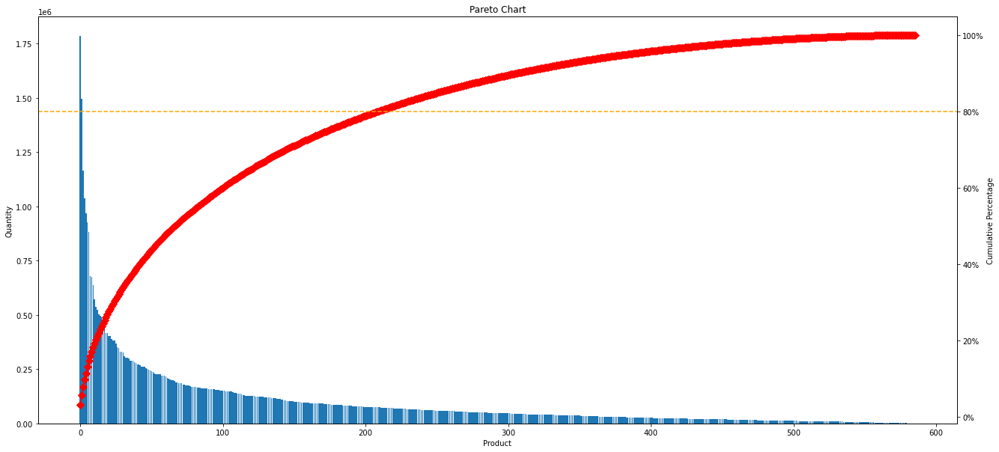

In [821]:
Qd_prod = Qd_zip_prod.groupby(['Product'])['Quantity'].sum().reset_index()
Pareto(Qd_prod)

Find top ten quantity demand ZIP

In [822]:
# Top 10 demand 3-digit code
TOP_10_ZIP=orders_raw.groupby(['ZIP_3d'])['Quantity'].sum().reset_index()
TOP_10_ZIP = TOP_10_ZIP.sort_values(by=['Quantity'], ascending = False).reset_index()
TOP_10_ZIP = TOP_10_ZIP.head(10)
TOP_10_ZIP = TOP_10_ZIP.drop(columns=['index'])
TOP_10_ZIP

,ZIP_3d,Quantity
0,100,618083
1,112,575267
2,606,513014
3,945,505731
4,331,464854
5,300,427521
6,70,427005
7,750,402989
8,21,380758
9,117,379145


### Top 10 ZIP by product

In [823]:
# extract top ten zip quantity demand by product
TOP_ZIP_prod= {}
iter_top_zip = TOP_10_ZIP['ZIP_3d'].unique()
for zip_3d in iter_top_zip:
    TOP_ZIP_prod[zip_3d] = Qd_zip_prod[Qd_zip_prod['ZIP_3d']==zip_3d]

# Display top ten zip
# \[100, 112, 606, 945, 331, 300,  70, 750,  21, 117\]
TOP_ZIP_prod[112]

,Product,ZIP_3d,Quantity
149,77,112,70
252,101,112,69
338,169,112,77
401,249,112,72
506,251,112,55
...,...,...,...
712777,382,112,83
713053,498,112,75
713113,500,112,78
713159,510,112,77


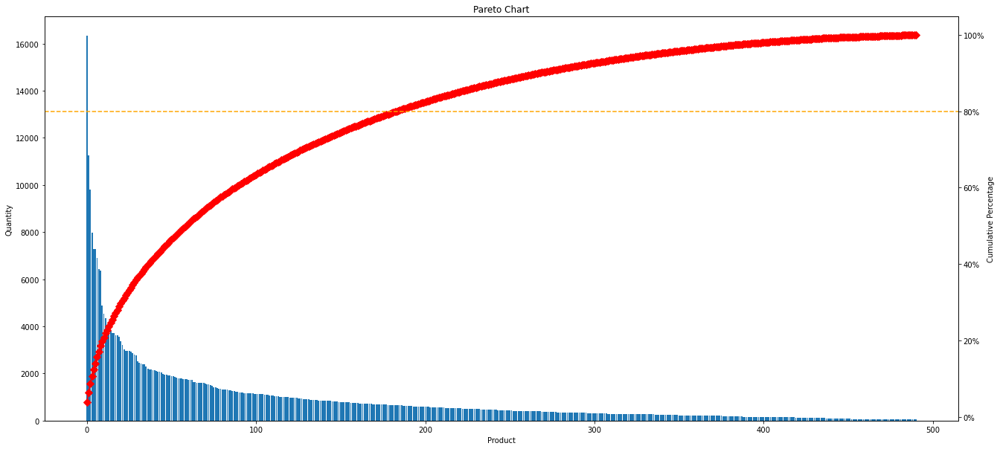

In [825]:
# Choose from top ten zip below
# 100, 112, 606, 945, 331, 300,  70, 750,  21, 117
Pareto(TOP_ZIP_prod[300])

# 2. Demand Forecast and Generation Over the Planning Horizon

In [80]:
daily_demand_hist = px.histogram(daily_demand_total, x="Quantity")
daily_demand_hist.show()

In [74]:
# data describtion
daily_demand_total['Quantity'].describe()

count       365.000000
mean     153923.073973
std       38866.904489
min       37380.000000
25%      131821.000000
50%      146345.000000
75%      167873.000000
max      434951.000000
Name: Quantity, dtype: float64

In [705]:
global_daily_demand.show()

In [113]:
def daily_2_my(df, m_or_y:str = "1M"):
    '''
    Inputs:
        df: daily df
        m_or_y: '1M'(monthly) or '1Y'(yearly)
        
    Outputs:
        required df
    '''
    res = df.copy()
    res.set_index('Order_Date', inplace=True)
    res.index = pd.to_datetime(res.index)
    res = res.resample(m_or_y).sum()
    res.reset_index(inplace=True)
    
    return res

In [114]:
def trend_generator(rate, length, variation = False, opt=None, cons=None):
    
    '''
    return: 
    if variation = true
    lsts of day trend, day trend opt, day trend cons, day counter
    
    if variation = false
    lsts of day trend, day counter
    '''
    
    if variation == False:
        
        lst_of_dt = []
        counter = []
        for i in range(length):
            lst_of_dt.append(pow(pow(rate, length/365), i/length))
            counter.append(i+1)
        return lst_of_dt, counter

In [115]:
da2024 = pd.date_range(start='1/1/2023', end='12/31/2024', freq = '1W')
da2025 = pd.date_range(start='1/1/2025', end='12/31/2025', freq = '1W')
da2028 = pd.date_range(start='1/1/2026', end='12/31/2028', freq = '1W')

date2024 = []
date2025 = []
date2028 = []

for i in da2024:
    date2024.append(i.strftime('%Y-%m-%d'))
    
for i in da2025:
    date2025.append(i.strftime('%Y-%m-%d'))
    
for i in da2028:
    date2028.append(i.strftime('%Y-%m-%d'))

date = date2024 + date2025 + date2028

In [116]:
len(date2024 + date2025 + date2028)

314

In [108]:
dt2024, counter =  trend_generator(1.5, len(date2024))
dt2025, counter =  trend_generator(2.0/1.5, len(date2025))
dt2028, counter =  trend_generator(1.5, len(date2028))

In [167]:
len(wkly2019)

51

In [168]:
def ramp_demand(prd, zip3):
    df = orders_raw[(orders_raw['Product']==prd) & (orders_raw['ZIP_3d']==zip3)]
    
    if len(df) == 0:
        return
        
    df = df.drop(axis = 1, columns = [
         'Product', 'product category', 'sub-category', 'ZIP_3d', 'Country'
    ])
    df.loc[0] = ['2019/1/1', 0] 
    df.loc[0] = ['2019/12/29', 0] 
    df = daily_2_my(df, "1W")
    
    wkly2019 = df['Quantity'].tolist()
    
    wkly2024 = wkly2019 + wkly2019 
    wkly2028 = wkly2019 + wkly2019 + wkly2019 
    wkly2024.append(wkly2019[-1])
    wkly2028.append(wkly2019[-1])
    
    dp2024 = [x*y for x,y in zip(dt2024,wkly2024)]
    dp2025 = [int(x*y) for x,y in zip(dt2025,[1.5*x for x in wkly2019])]
    dp2028 = [int(x*y) for x,y in zip(dt2028,[2*x for x in wkly2028])]
    
    res = pd.DataFrame()
    res['date'] = date
    res['Quantity'] = dp2024 + dp2025 + dp2028
    
    return res

In [1499]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

df_1 = ramp_demand(1,117)# 586 product
df_2 = ramp_demand(1,117)
df_3 = ramp_demand(1,117)
df_4 = ramp_demand(1,117)
df_5 = ramp_demand(1,117)
df_6 = ramp_demand(1,117)
df_7 = ramp_demand(1,117)
df_8 = ramp_demand(1,117)
df_9 = ramp_demand(1,117)
df_10 = ramp_demand(1,117)

fig = make_subplots(rows=10, cols=1)
fig.append_trace(go.Line(x = df_1['date'], y = df_1['Quantity']), row=1, col=1)
fig.append_trace(go.Line(x = df_2['date'], y = df_2['Quantity']), row=2, col=1)
fig.append_trace(go.Line(x = df_3['date'], y = df_3['Quantity']), row=3, col=1)
fig.append_trace(go.Line(x = df_4['date'], y = df_4['Quantity']), row=4, col=1)
fig.append_trace(go.Line(x = df_5['date'], y = df_5['Quantity']), row=5, col=1)
fig.append_trace(go.Line(x = df_6['date'], y = df_6['Quantity']), row=6, col=1)
fig.append_trace(go.Line(x = df_7['date'], y = df_7['Quantity']), row=7, col=1)
fig.append_trace(go.Line(x = df_8['date'], y = df_8['Quantity']), row=8, col=1)
fig.append_trace(go.Line(x = df_9['date'], y = df_9['Quantity']), row=9, col=1)
fig.append_trace(go.Line(x = df_10['date'], y = df_10['Quantity']), row=10, col=1)

fig.update_layout(height=600, width=600, title_text="Stacked Subplots")
fig.show()

In [200]:
df['index'] = range(1, len(df) + 1)
X = df['index'].values
y = df['Quantity'].values

In [451]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_squared_error

In [202]:
polys = []
degs = [1,2,3,4,5,8,12,15,16]
for deg in degs:
    polys.append(
                 Pipeline([('polynomial',PolynomialFeatures(degree=deg, include_bias = False)),('modal',LinearRegression())])
                )

In [203]:
y_preds = []
for poly in polys:
    model = poly.fit(X.reshape(-1,1), y.reshape(-1,1))
    y_pred = model.predict(X.reshape(-1,1))
    
    y_preds.append(y_pred)

In [204]:
mse_train = []
for y_pred in y_preds:
    mse_train.append(mean_squared_error(y,y_pred))

In [205]:
mse_train

[16482.90113706162,
 16469.444556893774,
 16385.50499077081,
 16383.425065252331,
 16381.905676309345,
 16335.972146782502,
 16361.311619803304,
 16480.40949251419,
 16532.134941418382]

In [206]:
px.scatter(x = degs, y = mse_train)

In [209]:
ypred = [x[0] for x in y_preds[8].tolist()]

In [210]:
px.line(x = X, y = y)

In [214]:
np.argmin(mse_train)

5

In [219]:
ypred = [x[0] for x in y_preds[np.argmin(mse_train)].tolist()]

In [220]:
px.line(x = X, y = ypred)

# 3.  Fulfillment Center Throughput and Storage Requirements

## a. Assign the zip codes to the most appropriate fulfillment center

In [49]:
!pip install haversine
import haversine as hs

In [901]:
DC=D_FC.head(2)
FC=D_FC.tail(20).reset_index()

FC_ZIP_state=FC[['ZIP','City','State']]

,ZIP,City,State
0,30336,Atlanta,GA
1,42276,Russellville,KY
2,76164,Fort Worth,TX
3,77078,Houston,TX
4,92395,Victorville,CA
5,95336,Manteca,CA
6,97230,Portland,OR
7,58801,Williston,ND
8,80204,Denver,CO
9,66115,Kansas City,KS


In [274]:
# extract each sub-category
sub_cate_coordinate = orders.groupby(['Order_Date','sub-category','ZIP3','Lat','Lon'])['Quantity'].sum().reset_index()

sub_cate = {}
iter_scat = sub_cate_coordinate ['sub-category'].unique()
for scat in iter_scat:
    sub_cate[scat] = sub_cate_coordinate[sub_cate_coordinate['sub-category']==scat]

# Display f/m/s
sub_cate['f']

,Order_Date,sub-category,ZIP3,Lat,Lon,Quantity
0,2019-01-01,f,10,42.221598,-72.573558,207
1,2019-01-01,f,12,42.396595,-73.237576,55
2,2019-01-01,f,15,42.241975,-71.767615,232
3,2019-01-01,f,16,42.264591,-71.793381,156
4,2019-01-01,f,17,42.335116,-71.417250,133
...,...,...,...,...,...,...
309422,2019-12-31,f,989,46.620679,-120.482577,59
309423,2019-12-31,f,992,47.661571,-117.396431,65
309424,2019-12-31,f,993,46.284993,-118.983570,127
309425,2019-12-31,f,994,46.385250,-117.035920,57


In [181]:
sub_cate_coordinate_s = sub_cate_coordinate.copy()
sub_cate_coordinate

,Order_Date,sub-category,ZIP3,Lat,Lon,Quantity
0,2019-01-01,f,10,42.221598,-72.573558,207
1,2019-01-01,f,12,42.396595,-73.237576,55
2,2019-01-01,f,15,42.241975,-71.767615,232
3,2019-01-01,f,16,42.264591,-71.793381,156
4,2019-01-01,f,17,42.335116,-71.417250,133
...,...,...,...,...,...,...
309781,2019-12-31,s,981,47.600318,-122.319288,393
309782,2019-12-31,s,983,47.476342,-122.592873,255
309783,2019-12-31,s,989,46.620679,-120.482577,144
309784,2019-12-31,s,992,47.661571,-117.396431,65


In [54]:
# combine coordinate
## convert df to list
loc_Lat = sub_cate_coordinate[['Lat']].values.tolist()
loc_Lon = sub_cate_coordinate[['Lon']].values.tolist()

FC_Lat = FC[['Lat']].values.tolist()
FC_Lon = FC[['Lon']].values.tolist()

DC_Lat = DC[['Lat']].values.tolist()
DC_Lon = DC[['Lon']].values.tolist()

## list of coordinates
loc_cord = []
for i, _ in enumerate(loc_Lat):
    loc_cord.append(loc_Lat[i]+loc_Lon[i])
    
FC_cord=[]
for i, _ in enumerate(FC_Lat):
    FC_cord.append(FC_Lat[i]+FC_Lon[i])

DC_cord=[]
for i, _ in enumerate(DC_Lat):
    DC_cord.append(DC_Lat[i]+DC_Lon[i])

Assign Fulfillment center by sub-category

In [306]:
## look for shortest distance and FC-zip
sub_cate_dis=sub_cate_coordinate.copy()
FC_dis={}
FC_zip_lst=[]
FC_dis_lst=[]
for loc in range(len(loc_cord)):
    for i in range(len(FC_cord)):  
        FC_dis[FC['ZIP'][i]]=(hs.haversine(loc_cord[loc],FC_cord[i]))
    FC_zip_lst.append(min(FC_dis, key=FC_dis.get))
    FC_dis_lst.append(FC_dis[min(FC_dis, key=FC_dis.get)])
sub_cate_dis['ZIP'] =FC_zip_lst
sub_cate_dis['FC_dist'] = FC_dis_lst
sub_cate_dis=pd.merge(FC_ZIP_state,sub_cate_dis, on='ZIP')

In [309]:
sub_cate_dis

,ZIP,City,State,Order_Date,sub-category,ZIP3,Lat,Lon,Quantity,FC_dist
0,30336,Atlanta,GA,2019-01-01,f,270,36.170495,-80.388236,129,444.803276
1,30336,Atlanta,GA,2019-01-01,f,271,36.091410,-80.256988,67,449.691413
2,30336,Atlanta,GA,2019-01-01,f,280,35.339062,-80.990378,207,350.143304
3,30336,Atlanta,GA,2019-01-01,f,281,35.311598,-80.767852,207,366.783796
4,30336,Atlanta,GA,2019-01-01,f,282,35.215021,-80.832653,159,356.879750
...,...,...,...,...,...,...,...,...,...,...
309781,85017,Phoenix,AZ,2019-12-31,m,857,32.270174,-110.979043,200,170.648261
309782,85017,Phoenix,AZ,2019-12-31,m,871,35.084465,-106.642586,147,527.485779
309783,85017,Phoenix,AZ,2019-12-31,s,852,33.444429,-111.919763,266,14.758210
309784,85017,Phoenix,AZ,2019-12-31,s,853,33.495005,-112.499918,128,40.868256


## Result: Assign Each 3-digit Zip to FC

In [308]:
## assign 3-zip to FC-zip
sub_cate_FC=sub_cate_dis.groupby(['ZIP','City','State','ZIP3','sub-category','FC_dist'])['Quantity'].sum().reset_index()
sub_cate_FC

,ZIP,City,State,ZIP3,sub-category,FC_dist,Quantity
0,2118,Boston,MA,10,f,123.939132,55458
1,2118,Boston,MA,10,m,123.939132,15258
2,2118,Boston,MA,10,s,123.939132,8883
3,2118,Boston,MA,11,f,127.021561,20920
4,2118,Boston,MA,11,m,127.021561,4528
...,...,...,...,...,...,...,...
2650,97230,Portland,OR,998,m,1644.632546,553
2651,97230,Portland,OR,998,s,1644.632546,544
2652,97230,Portland,OR,999,f,1344.321339,1839
2653,97230,Portland,OR,999,m,1344.321339,126


In [1619]:
FC_ZIP

,ZIP,City,State,ZIP_3d
0,2118,Boston,MA,10
1,2118,Boston,MA,11
2,2118,Boston,MA,12
3,2118,Boston,MA,13
4,2118,Boston,MA,14
...,...,...,...,...
885,97230,Portland,OR,995
886,97230,Portland,OR,996
887,97230,Portland,OR,997
888,97230,Portland,OR,998


## FC - 3 digit Zip

### FC capacity

In [1622]:
# Capacity for each FC by sub-category
sub_cate_Qd_FC = sub_cate_dis.groupby(['ZIP','sub-category'])['Quantity'].sum().reset_index()

# Capacity for each FC with state and state_code by sub-category
sub_cate_Qd_FC_state = pd.merge(sub_cate_Qd_FC, FC, on='ZIP').dropna()
sub_cate_Qd_FC_state = sub_cate_Qd_FC_state[['ZIP','sub-category','Quantity','City','State','Lat','Lon']]

In [1623]:
# Yearly total quantity demand for each FC
sub_tot_Qd_FC = sub_cate_Qd_FC.groupby(['ZIP'])['Quantity'].sum().reset_index()
sub_tot_Qd_FC = pd.merge(FC_ZIP_state,sub_tot_Qd_FC, on='ZIP')

In [1624]:
# extract FC ZIP & sum Qd for each sub-category
sub_cate_FC = {}
iter_scat = sub_Qd_FC['sub-category'].unique()
for scat in iter_scat:
    sub_cate_FC[scat] = sub_Qd_FC[sub_Qd_FC['sub-category']==scat]

# Display f/m/s
sub_cate_FC['f']

,sub-category,ZIP,20d,Quantity,City,State
0,f,2118,1,102663,Boston,MA
1,f,2118,2,71826,Boston,MA
2,f,2118,3,105014,Boston,MA
3,f,2118,4,109153,Boston,MA
4,f,2118,5,96685,Boston,MA
...,...,...,...,...,...,...
1097,f,97230,15,80934,Portland,OR
1098,f,97230,16,80133,Portland,OR
1099,f,97230,17,107316,Portland,OR
1100,f,97230,18,91654,Portland,OR


In [651]:
# Quantity Demand in each FC by Sub-category
def sub_q_FC(df):
    df_plot= px.line(df, x="20d", y="Quantity", color='City', title='Quantity Demand in FC by Sub-category')
    df_plot.show()

In [652]:
sub_q_FC(sub_cate_FC['f'])

In [653]:
sub_q_FC(sub_cate_FC['m'])

In [654]:
sub_q_FC(sub_cate_FC['s'])

We assume that the FC can satisfy largest demand in 2019

d_p: Demand for product p, units per period = sub_cate_FC(\['f'\])
t_p: Processing time for product p, unit times per product unit = 24 hr\
Assume q_p: Quality achieved by resource for product p (0-1 ratio) = 1\
a: Availability of resource, unit times per period\
r:  Reliability of resource (0-1 ratio)\
e: Efficiency of resource (0-1 ratio)

In [655]:
# Max number of demand by 20days in each FC as their FC capacity
FC_capacity = pd.merge(sub_cate_FC['f'], FC, on='ZIP')
FC_capacity = FC_capacity.groupby(['ZIP'])['Quantity'].max().reset_index()
FC_capacity = pd.merge(FC_ZIP_state, FC_capacity, on='ZIP')
FC_capacity

,ZIP,City,State,Quantity
0,30336,Atlanta,GA,258818
1,42276,Russellville,KY,156079
2,76164,Fort Worth,TX,126038
3,77078,Houston,TX,143776
4,92395,Victorville,CA,189925
5,95336,Manteca,CA,142988
6,97230,Portland,OR,108289
7,58801,Williston,ND,17557
8,80204,Denver,CO,80768
9,66115,Kansas City,KS,92206


## b. Demand forecasts for the throughput of each FC by combination of product and week from 2023 to 2028.

## c.  Leveraging b. and 3.1.2.b,  extend your simulator capabilities to enable generating  FC order scenarios. Use it to stochastically generate at least ten scenarios over the 2023-2028  horizon. Analyze and synthesize your results in terms of FC outbound throughput capacity requirements.


## d. Analyze and synthesize your results in terms of FC storage and inbound throughput capacity requirements 

### Robust Demand Satisfaction Requirement during Target Lead Time

In [871]:
fast_count = len(category[category['Sub-category']=='f'])
mid_count = len(category[category['Sub-category']=='m'])
slow_count = len(category[category['Sub-category']=='s'])
print(fast_count)
print(mid_count)
print(slow_count)

147
145
504


In [1035]:
FC_ZIP=FC_ZIP.rename(columns={'ZIP3':'ZIP_3d'})
FC_ZIP

,ZIP,City,State,ZIP_3d
0,2118,Boston,MA,10
1,2118,Boston,MA,11
2,2118,Boston,MA,12
3,2118,Boston,MA,13
4,2118,Boston,MA,14
...,...,...,...,...
885,97230,Portland,OR,995
886,97230,Portland,OR,996
887,97230,Portland,OR,997
888,97230,Portland,OR,998


b: Base period = 1 week= 7days =24hrs \
l: Target order to shipping time in hrs{ f= 24, m=48, s=72}\
s: Target service level for on-time shipping :99%\
d^b: Expected average demand during baseline period, product unit per period= average weekly demand by product\
sigma^2_b: Expected demand variance during b for each product\
z_s: normal distribution z factor for s: 2.33\
D_ls: robust demand satisfaction requirement during l given s 

In [1073]:
daily_orders_prd = orders_raw[['Order_Date','Product','product category','Quantity','sub-category','ZIP_3d']]
daily_orders_prd = pd.merge(daily_orders_prd,FC_ZIP, on='ZIP_3d')
daily_orders_prd['Order_Date'] =  pd.to_datetime(daily_orders_prd['Order_Date'])
daily_orders_prd = daily_orders_prd.drop(columns=['ZIP_3d'])

In [1100]:
# extract FC daily demand by product
daily_FC_prod_Qd= {}
iter_FC_state = FC_ZIP['State'].unique()
for state in iter_FC_state:
    daily_FC_prod_Qd[state] = daily_orders_prd[daily_orders_prd['State']==state]

# Display FC Quantity by product category
# MA, NY, PA, MD, GA, FL, KY, MI, ND, IL, KS, TX, CO, UT, AZ, CA, OR
daily_FC_prod_Qd['NY']

,Order_Date,Product,product category,Quantity,sub-category,ZIP,City,State
0,2019-01-01,1,A,61,f,11378,Maspeth,NY
1,2019-01-01,1,A,84,f,11378,Maspeth,NY
2,2019-01-01,7,A,83,f,11378,Maspeth,NY
3,2019-01-01,8,A,56,f,11378,Maspeth,NY
4,2019-01-01,255,H,68,f,11378,Maspeth,NY
...,...,...,...,...,...,...,...,...
710548,2019-12-22,502,R,67,f,11378,Maspeth,NY
710549,2019-12-22,502,R,57,f,11378,Maspeth,NY
710550,2019-12-22,670,U,70,f,11378,Maspeth,NY
710551,2019-12-23,65,C,71,s,11378,Maspeth,NY


In [1101]:
# Weekly Demand by product 2019 data
# Getting week value
def get_Week(df):
    df_c=df.copy()
    df_c['Week']= df_c['Order_Date'].dt.isocalendar().week

    df_var=df_c.groupby(['Week','Product','sub-category'])['Quantity'].var().reset_index() #calculate weekly variance for each product 
    df_c= pd.merge(df_c,df_var, on=['Product','sub-category','Week'])

    df_c= df_c.rename(columns={'Quantity_x': 'Quantity', 'Quantity_y': 'Variance'}) #renamen col names

    weekly_orders_prd=df_c.groupby(['Week','Product','product category','sub-category','Variance'])['Quantity'].sum().reset_index()
    weekly_orders_prd = weekly_orders_prd.rename(columns={"ZIP_y":"FC_ZIP","City_y":"FC City","State_y":"FC State"})
    return weekly_orders_prd

In [1464]:
wkly=get_Week(daily_FC_prod_Qd['GA'])
wkly.to_csv("GA_weekly.csv")

In [1186]:
def Robust_Demand(state:str):
    df_state=get_Week(daily_FC_prod_Qd[state])
    df_state['Robust Demand'] = ""
    for i in range(len(df_state)):
        exp_d = df_state.loc[i,'Quantity']
        sigma = df_state.loc[i,'Variance']
        if df_state.loc[i,'sub-category']=='f':
            df_state.loc[i,'Robust Demand']= math.ceil(exp_d*(1/7)+2.33*np.sqrt(sigma*(1/7)))
        elif df_state.loc[i,'sub-category']=='m':
            df_state.loc[i,'Robust Demand']= math.ceil(exp_d*(2/7)+2.33*np.sqrt(sigma*(2/7)))
        elif df_state.loc[i,'sub-category']=='s':
            df_state.loc[i,'Robust Demand']= math.ceil(exp_d*(3/7)+2.33*np.sqrt(sigma*(3/7)))
    return df_state

In [1187]:
Robust_Demand('NY')

,Week,Product,product category,sub-category,Variance,Quantity,Robust Demand
0,1,1,A,f,108.962500,1123,170
1,1,2,A,f,716.500000,775,135
2,1,3,A,f,657.410714,581,106
3,1,4,A,f,869.142857,664,121
4,1,5,A,f,29.571429,502,77
...,...,...,...,...,...,...,...
12486,52,764,Y,m,4.500000,121,38
12487,52,765,Y,m,12.500000,125,41
12488,52,769,Y,m,633.333333,256,105
12489,52,770,Y,s,22.333333,233,108


### Robust Capacity

b: Base period = 1 week =7 days\
l: Target order to shipping time in hrs{ f= 24, m=48, s=72}\
s: Target service level for on-time shipping :99%\
t: process time, unit times days{ f= 28*24*60/147=275, m=56*24*60/145=556, s=112*24*60/504=320}\
! Assume q: quailty achieve =90%\
Assume a^b: availity of production resources {f= 2400/5*275=132000, m=2400/5*556=266880, s=2400/5*320=153600} \
r: reliability of production resources\
e: efficienty of production\
D_ls\
C_ls\
C_ls=(d_ls\*t\*b)/(q\*a^b\*r\*e\*l)

In [1537]:
def Robust_Capacity(state:str):
    df_state=Robust_Demand(state)
    df_state['Robust Capacity'] = ""
    for i in range(len(df_state)):
        exp_rd = df_state.loc[i,'Robust Demand']
        if df_state.loc[i,'sub-category']=='f':
            df_state.loc[i,'Robust Capacity']= math.ceil((float(exp_rd)*7*275)/(0.9*132000*0.9*0.9*1))
        elif df_state.loc[i,'sub-category']=='m':
            df_state.loc[i,'Robust Capacity']= math.ceil((float(exp_rd)*7*556)/(0.9*266880*0.9*0.9*2))
        elif df_state.loc[i,'sub-category']=='s':
            df_state.loc[i,'Robust Capacity']= math.ceil((float(exp_rd)*7*320)/(0.9*153600*0.9*0.9*3))
    return df_state

In [1538]:
Robust_Capacity('GA')

,Week,Product,product category,sub-category,Variance,Quantity,Robust Demand,Robust Capacity
0,1,1,A,f,31.125000,515,79,2
1,1,2,A,f,365.363636,893,145,3
2,1,3,A,f,590.177778,722,125,3
3,1,4,A,f,1347.285714,605,119,3
4,1,5,A,f,278.952381,556,95,2
...,...,...,...,...,...,...,...,...
10325,52,694,U,s,112.500000,133,74,1
10326,52,758,Y,f,72.214286,598,93,2
10327,52,760,Y,f,5208.333333,422,124,3
10328,52,761,Y,f,8.000000,146,24,1


### Inventory

Assumption:\
Demand=production\
Demand = Quantity Demand \[weekly_orders_prd['Quantity]\]\
Cumulative Demand: wk_sub_cate\['sub_cat'\]\
Fully Smoothed cumulative Production= cumulative capacity\
Fully Smoother Inventory = Fully Smoothed Production - Cumulative Demand\

In [1557]:
def Inventory(state:str):
    df_state=Robust_Capacity(state)
    df_state['Robust Inventory']= df_state['Robust Capacity']*50- df_state['Robust Demand']
    INV = [-x if x <0 else 0 for x in df_state['Robust Inventory']]
    INV_int=[]
    for i in INV:
        INV_int.append(math.ceil(i))
    df_state['Robust Inventory']= INV_int
    return df_state

In [1558]:
Inventory('GA')

,Week,Product,product category,sub-category,Variance,Quantity,Robust Demand,Robust Capacity,Robust Inventory
0,1,1,A,f,31.125000,515,79,2,0
1,1,2,A,f,365.363636,893,145,3,0
2,1,3,A,f,590.177778,722,125,3,0
3,1,4,A,f,1347.285714,605,119,3,0
4,1,5,A,f,278.952381,556,95,2,0
...,...,...,...,...,...,...,...,...,...
10325,52,694,U,s,112.500000,133,74,1,24
10326,52,758,Y,f,72.214286,598,93,2,0
10327,52,760,Y,f,5208.333333,422,124,3,0
10328,52,761,Y,f,8.000000,146,24,1,0


In [1559]:
inv_plot = Inventory('GA')
fig = px.line(x = inv_plot['Week'], y = inv_plot['Robust Inventory'])
fig.show()

## Replenishement based on Inventory 

replenishment = Demand- inventory\
apply robust demand function

b: Base period = 1 week= 7days =24hrs \
l: Target order to shipping time in days{ f= 28, m=56, s=112}\
s: Target service level for on-time shipping :99.9%\
d^b: Expected average demand during baseline period, product unit per period= average weekly inventory by product\
sigma^2_b: Expected demand variance during b for each product: linear transformation, inventory variance equals to demand variance\
z_s: normal distribution z factor for s: 3.08\
D_ls: robust demand satisfaction requirement during l given s 

In [1569]:
def Replenish(state:str):
    df=Inventory(state)
    Rep = df.groupby(['Week','Product', 'product category','sub-category'])['Robust Inventory'].sum().reset_index()
    Rep = Rep.rename(columns={'Robust Inventory':'Replenishment'})
    return Rep

In [1570]:
Replenish('MA')

,Week,Product,product category,sub-category,Replenishment
0,1,1,A,f,0
1,1,2,A,f,0
2,1,3,A,f,0
3,1,4,A,f,0
4,1,5,A,f,0
...,...,...,...,...,...
6473,52,673,U,f,0
6474,52,680,U,m,3
6475,52,685,U,m,45
6476,52,764,Y,m,6


In [1572]:
rep_plot = Replenish('MA')
fig_rep_plot = px.line(x = rep_plot['Week'], y = rep_plot['Replenishment'])
fig_rep_plot.show()

# 4. Distribution Center Throughput and Storage Requirements
## a. Assign DC

In [1067]:
## look for shortest distance FC vs DC
DF_zip=FC.copy()
FD_dis={}
FD_zip_lst=[]
FD_dis_lst=[]
for loc in range(len(FC_cord)):
    for i in range(len(DC_cord)):  
        FD_dis[DC['ZIP'][i]]=(hs.haversine(DC_cord[i],FC_cord[loc]))
    FD_zip_lst.append(min(FD_dis, key=FD_dis.get))
    FD_dis_lst.append(FD_dis[min(FD_dis, key=FD_dis.get)])
DF_zip['ZIP_DC'] =FD_zip_lst
DF_zip['FC_dist'] = FD_dis_lst

## assign 3-zip to FC-zip
DF_zip

,index,S. No.,Role,ZIP,City,State,Country,ZIP_3,Lat,Lon,ZIP_DC,FC_dist
0,2,3,FC,30336,Atlanta,GA,US,303,33.822421,-84.342545,31405,358.467448
1,3,4,FC,42276,Russellville,KY,US,422,36.907159,-87.117858,31405,768.887520
2,4,5,FC,76164,Fort Worth,TX,US,761,32.756322,-97.271529,31405,1516.836277
3,5,6,FC,77078,Houston,TX,US,770,29.770498,-95.415197,31405,1386.529980
4,6,7,FC,92395,Victorville,CA,US,923,34.283624,-117.286247,92509,49.061501
5,7,8,FC,95336,Manteca,CA,US,953,37.623269,-120.877263,92509,530.972097
6,8,9,FC,97230,Portland,OR,US,972,45.527154,-122.682063,92509,1378.155589
7,9,10,FC,58801,Williston,ND,US,588,48.274431,-103.521921,92509,1969.897559
8,10,11,FC,80204,Denver,CO,US,802,39.736271,-104.997948,92509,1273.454938
9,11,12,FC,66115,Kansas City,KS,US,661,39.095282,-94.655244,31405,1449.772641


In [1068]:
DF_zip_Qd = pd.merge(sub_tot_Qd_FC,DF_zip,on='ZIP')
DF_zip_Qd = DF_zip_Qd.groupby(['ZIP_DC'])['Quantity'].sum().reset_index()
DF_zip_Qd

,ZIP_DC,Quantity
0,31405,41781197
1,92509,14400725


## Robust Capacity in DC

f: 28\
m: 56\
s: 112\
b= 20 days

In [1632]:
FC_state_lst=FC_ZIP['State'].unique()
list(FC_state_lst)
iter_cate = orders_raw['product category'].unique()

In [1500]:
FC_state_lst

array(['MA', 'NY', 'PA', 'MD', 'GA', 'FL', 'KY', 'MI', 'ND', 'IL', 'KS',
       'TX', 'CO', 'UT', 'AZ', 'CA', 'OR'], dtype=object)

In [1531]:
DC_20d_prd.to_csv

,20d,Product,product category,sub-category,Variance,Quantity
0,1,1,A,f,503.109874,22550
1,1,2,A,f,479.256168,20638
2,1,3,A,f,1580.275659,20203
3,1,4,A,f,287.572769,16352
4,1,5,A,f,2777.847772,18509
...,...,...,...,...,...,...
10388,19,777,Y,s,70.700000,399
10389,19,778,Y,s,46.333333,250
10390,19,783,Y,s,157.000000,216
10391,19,786,Y,s,32.000000,120


In [1596]:
DC_list=[]
for state in FC_state_lst:
    day_DC = daily_FC_prod_Qd[state]
    DC_list.append(day_DC)
    DC_wk_prd=pd.concat(DC_list)

DC_wk_prd['20d'] = DC_wk_prd['Order_Date'].apply(lambda x: datetime_to_num_of_twenty(dt_val=x))
DC_var = DC_wk_prd.groupby(['20d','Product','product category','sub-category'])['Quantity'].var().reset_index() 
DC_var = DC_var.rename(columns={'Quantity':'Variance'})
DC_wk_prd=pd.merge(DC_var,DC_wk_prd, on=['20d','Product','product category','sub-category'])
DC_wk_prd  ## with week
DC_20d_prd = DC_wk_prd.groupby(['20d', 'Product', 'product category', 'sub-category', 'Variance'])['Quantity'].sum().reset_index()

# Robust Demand
DC_20d_prd['Robust Demand'] = ""
for i in range(len(DC_20d_prd)):
    exp_d = DC_20d_prd.loc[i,'Quantity']
    sigma = DC_20d_prd.loc[i,'Variance']
    if DC_20d_prd.loc[i,'sub-category']=='f':
        DC_20d_prd.loc[i,'Robust Demand']= math.ceil(exp_d*(28/20)+3.08*np.sqrt(sigma*(28/20)))
    elif DC_20d_prd.loc[i,'sub-category']=='m':
        DC_20d_prd.loc[i,'Robust Demand']= math.ceil(exp_d*(56/20)+3.08*np.sqrt(sigma*(56/20)))
    elif DC_20d_prd.loc[i,'sub-category']=='s':
        DC_20d_prd.loc[i,'Robust Demand']= math.ceil(exp_d*(112/20)+3.08*np.sqrt(sigma*(112/20)))
        
# Robust Capacity
DC_20d_prd['Robust Capacity'] = ""
for i in range(len(DC_20d_prd)):
    exp_rd = DC_20d_prd.loc[i,'Robust Demand']
    if DC_20d_prd.loc[i,'sub-category']=='f':
        DC_20d_prd.loc[i,'Robust Capacity']= math.ceil((float(exp_rd)*20*275)/(0.9*132000*0.9*0.9*28))
    elif DC_20d_prd.loc[i,'sub-category']=='m':
        DC_20d_prd.loc[i,'Robust Capacity']= math.ceil((float(exp_rd)*20*556)/(0.9*266880*0.9*0.9*56))
    elif DC_20d_prd.loc[i,'sub-category']=='s':
        DC_20d_prd.loc[i,'Robust Capacity']= math.ceil((float(exp_rd)*20*320)/(0.9*153600*0.9*0.9*112))
        
# Robust Inventory
DC_20d_prd['Robust Inventory']= DC_20d_prd['Robust Capacity']*50- DC_20d_prd['Robust Demand']
Inv = [-x if x <0 else 0 for x in DC_20d_prd['Robust Inventory']]
Inv_int=[]
for i in Inv:
    Inv_int.append(math.ceil(i))
DC_20d_prd['Robust Inventory']= Inv_int

Rep = DC_20d_prd.groupby(['20d','Product', 'product category','sub-category'])['Robust Inventory'].sum().reset_index()
Rep_DC = Rep.rename(columns={'Robust Inventory':'Demand'})
# Based on Demand calculate the DC Inventory
Rep_DC['Robust Capacity'] = ""
for i in range(len(Rep_DC)):
    exp_rd = Rep_DC.loc[i,'Demand']
    if Rep_DC.loc[i,'sub-category']=='f':
        Rep_DC.loc[i,'Robust Capacity']= math.ceil((float(exp_rd)*20*275)/(0.9*132000*0.9*0.9*28))
    elif Rep_DC.loc[i,'sub-category']=='m':
        Rep_DC.loc[i,'Robust Capacity']= math.ceil((float(exp_rd)*20*556)/(0.9*266880*0.9*0.9*56))
    elif Rep_DC.loc[i,'sub-category']=='s':
        Rep_DC.loc[i,'Robust Capacity']= math.ceil((float(exp_rd)*20*320)/(0.9*153600*0.9*0.9*112))
        
# Robust Inventory
Rep_DC['Robust Inventory']=50*Rep_DC['Robust Capacity']- Rep_DC['Demand']
Inv_D = [-x if x <0 else 0 for x in Rep_DC['Robust Inventory']]
Inv_int_D=[]
for i in Inv_D:
    Inv_int_D.append(math.ceil(i))
Rep_DC['Robust Inventory']= Inv_int_D
Rep_DC

,20d,Product,product category,sub-category,Demand,Robust Capacity,Robust Inventory
0,1,1,A,f,28402,58,25502
1,1,2,A,f,25973,54,23273
2,1,3,A,f,25480,53,22830
3,1,4,A,f,20605,43,18455
4,1,5,A,f,23405,48,21005
...,...,...,...,...,...,...,...
10388,19,777,Y,s,2196,2,2096
10389,19,778,Y,s,1400,1,1350
10390,19,783,Y,s,1251,1,1201
10391,19,786,Y,s,664,1,614


In [ ]:
Rep_DC.

In [1595]:
fig_DC_plot = px.line(x = Rep_DC['20d'], y = Rep_DC['Robust Inventory'])
fig_DC_plot.show()

## c.

# 5.

FC_ZIP: FC Zip matched with ZIP_3d\
orders_raw: product category

## 2019 Dimension by each FC based on Robust Capacity

In [1605]:
def get_dim(state:str):
    dim = pd.read_excel(xls, 'Modular Package Dimensions')
    FC_state= Robust_Capacity(state).groupby(['Week','product category'])['Robust Capacity'].sum().reset_index()
    L=[]
    W=[]
    H=[]
    Weight=[]
    for i in range(len(FC_state)):
        for cate in iter_cate:
            if FC_state.iloc[i]['product category']==cate:
                FC_state_c = FC_state.iloc[i]['Robust Capacity']
                l = dim.loc[dim['Category'] == cate, 'L (ft)'].item()
                w = dim.loc[dim['Category'] == cate, 'W (ft)'].item()
                h = dim.loc[dim['Category'] == cate, 'H (ft)'].item()
                weight = dim.loc[dim['Category'] == cate, ' Weight (lbs)'].item()
                L.append(FC_state_c*l)
                W.append(FC_state_c*w)
                H.append(h)
                Weight.append(FC_state_c*weight)
    FC_state['L(ft)']=L
    FC_state['W(ft)']=W
    FC_state['H(ft)']=H #no need to multiply
    FC_state['Weight(lbs)']=Weight
    
    FC_cate_Qd_state=FC_state.groupby(['Week','product category'])['L(ft)','W(ft)','H(ft)','Weight(lbs)'].sum().reset_index()
    largest_L = FC_cate_Qd_state['L(ft)'].max()
    largest_W = FC_cate_Qd_state['W(ft)'].max()
    largest_H = FC_cate_Qd_state['H(ft)'].max()
    largest_Weight = FC_cate_Qd_state['Weight(lbs)'].max()
    print('L:',largest_L,'ft')
    print('W:',largest_W,'ft')
    print('H:',largest_H,'ft')
    dim = largest_L*largest_W*largest_H
    area = largest_L*largest_W
    print('Area',area,'ft^2')
    return largest_L, largest_W, largest_H, largest_Weight

use largest capacity in one year

In [1606]:
get_dim('NY')

L: 960.0 ft
W: 480.0 ft
H: 4.0 ft
Area 460800.0 ft^2


(960.0, 480.0, 4.0, 1360.0)

## 2019 Dimension Requirement for DC based on replenishment
sum of FC since we only choose one DC

In [1625]:
# Convert datetime to 20 days intervals
def datetime_to_num_of_twenty(dt_val=None):
    if isinstance(dt_val,datetime.date):
        dt_val = dt_val.timetuple().tm_yday
        result = int((dt_val-1)/20)+1
        return result
    else:
        return TypeError("Need to convert value to a datetime type")

In [1627]:
DC_dim={}
DC_re = Rep_DC.groupby(['20d','product category'])['Robust Inventory'].sum().reset_index()
DC_L=[]
DC_W=[]
DC_H=[]
DC_Weight=[]
for cate in iter_cate:
    for i in range(len(DC_re)):
        if DC_re.iloc[i]['product category']==cate:
            DC_rep_c = DC_re.iloc[i]['Robust Inventory']
            l = dim.loc[dim['Category'] == cate, 'L (ft)'].item()
            w = dim.loc[dim['Category'] == cate, 'W (ft)'].item()
            h = dim.loc[dim['Category'] == cate, 'H (ft)'].item()
            weight = dim.loc[dim['Category'] == cate, ' Weight (lbs)'].item()
            DC_L.append(DC_rep_c*l)
            DC_W.append(DC_rep_c*w)
            DC_H.append(h)
            DC_Weight.append(DC_rep_c*weight)
DC_re['L(ft)']=DC_L
DC_re['W(ft)']=DC_W
DC_re['H(ft)']=DC_H #no need to multiply
DC_re['Weight(lbs)']=DC_Weight
DC_re

,20d,product category,Robust Inventory,L(ft),W(ft),H(ft),Weight(lbs)
0,1,A,319155,1914930.0,1276620.0,3.0,3510705.0
1,1,B,36744,1667232.0,1111488.0,3.0,3056592.0
2,1,C,98828,1959432.0,1306288.0,3.0,3592292.0
3,1,D,995063,1930482.0,1286988.0,3.0,3539217.0
4,1,E,5369,1702674.0,1135116.0,3.0,3121569.0
...,...,...,...,...,...,...,...
460,19,U,161523,3669.0,3669.0,3.0,5503.5
461,19,V,792,2181.0,2181.0,3.0,3271.5
462,19,W,1058,1749.0,1749.0,3.0,2623.5
463,19,X,542,1716.0,1716.0,3.0,2574.0


In [1629]:
sum(DC_re['Robust Inventory'])

107135815

In [1611]:
DC_cate_Qd_state=DC_re.groupby(['20d','product category'])['L(ft)','W(ft)','H(ft)','Weight(lbs)'].sum().reset_index()
larg_L = DC_cate_Qd_state['L(ft)'].max()/1000
larg_W = DC_cate_Qd_state['W(ft)'].max()/1000
larg_H = DC_cate_Qd_state['H(ft)'].max()*4
larg_Weight = DC_cate_Qd_state['Weight(lbs)'].max()
print('L:',larg_L,'ft')
print('W:',larg_W,'ft')
print('H:',larg_H,'ft')
print('Weight:',larg_Weight,'lbs')
dim_3D = larg_L*larg_W*larg_H
area_DC = larg_L*larg_W
print('Area',area_DC,'ft^2')

L: 8322.588 ft
W: 4783.419 ft
H: 16.0 ft
Weight: 11790333.0 lbs
Area 39810425.568372 ft^2
